In [6]:
import pandas as pd
import csv
from PIL import Image
from IPython.display import display

# Results Seminar

## Research Question

**How do generative AI-based models (LaMa and Stable Diffusion) perform in object removal tasks compared to traditional inpainting methods (OpenCV) ?**

## EDA

- 1000 Images



## Models

- **Baseline: OpenCV**
OpenCV's inpainting methods, fill missing regions by propagating pixel information from the surrounding area. These traditional methods work well for small gaps but struggle with complex textures and large missing regions.

- **Stable Diffusion**
Stable Diffusion is a generative AI model that uses a latent diffusion process to iteratively refine noisy inputs into high-quality images. For inpainting, it conditions the diffusion process on the known parts of the image to generate realistic completions for missing regions.

- **LaMa**
LaMa (Large Mask Inpainting) is a deep learning-based model designed for inpainting large missing regions by leveraging Fourier convolutions and attention mechanisms. It efficiently reconstructs complex textures and structures while maintaining global coherence in images.

## Evaluation Metric


### Fréchet Inception Distance (FID)

* What it is: FID measures the similarity between real and generated images using deep neural network features.
* How it works: 
    - Extracts high-level features from images using a pre-trained Inception model
    - Computes the Fréchet Distance between the feature distributions of real (ground truth) and generated (inpainted) images.
    - Lower FID values indicate better image quality and realism.
* Why it’s used for inpainting:
    - Ensures that the inpainted regions are perceptually similar to real images.
    - Measures global consistency (not just pixel-wise similarity).

## Experimental Results

In [2]:
img1 = Image.open('Vis/Collage/viswithtitle1.png')
img2 = Image.open('Vis/Collage/viswithtitle2.png')
img3 = Image.open('Vis/Collage/viswithtitle3.png')


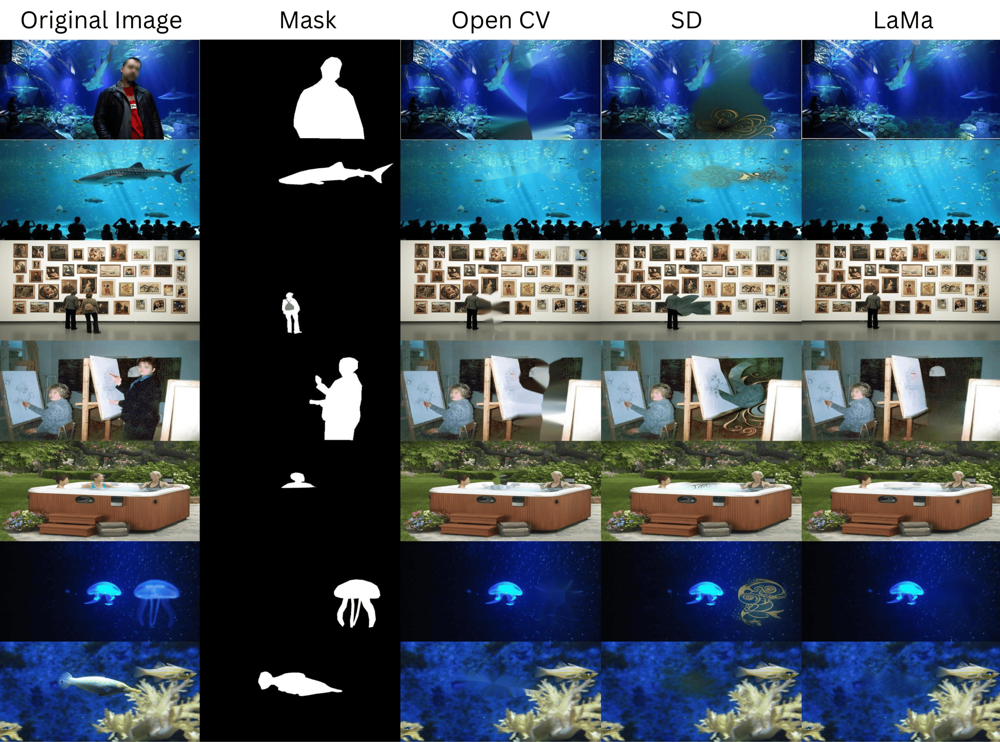

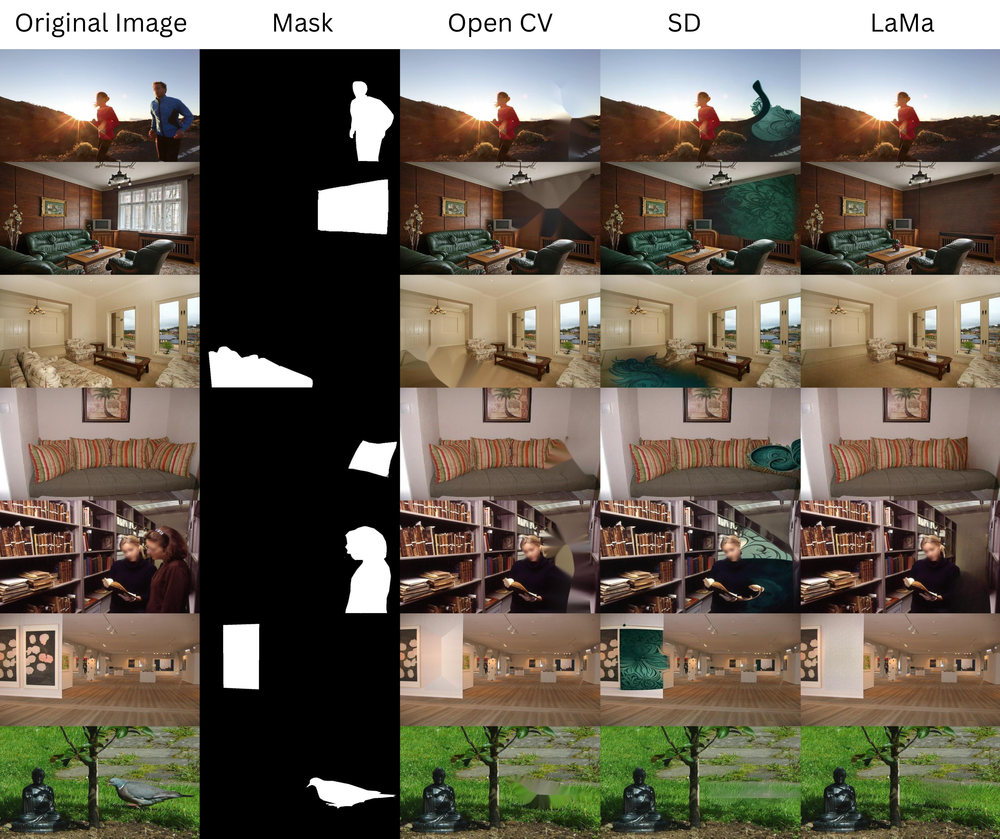

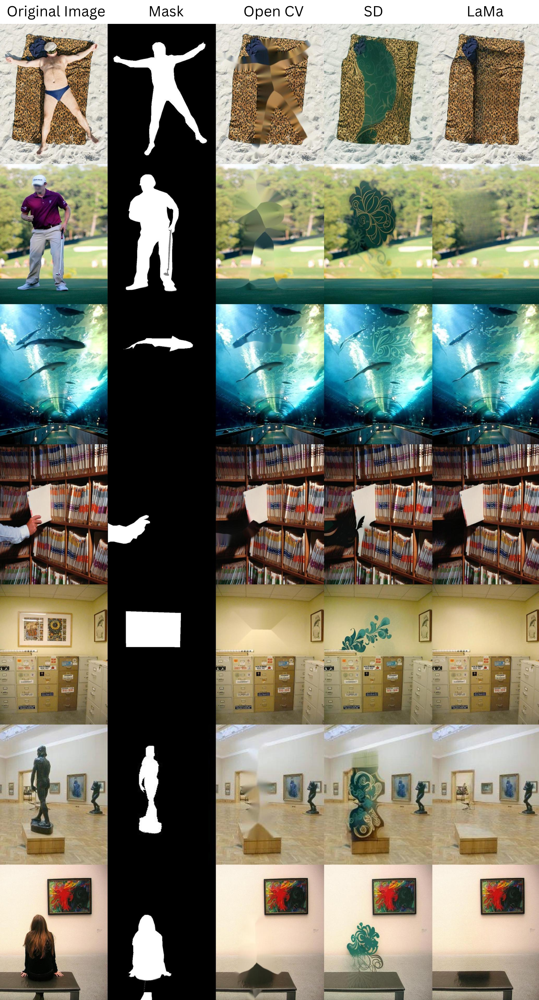

In [5]:
display(img1, img2, img3)

In [4]:
Baseline_FID = 37.68
LaMa_FID = 31.58
SD_FID = 49.47

# Verbesserung in % berechnen
def calculate_improvement(baseline, model):
    return round(((baseline - model) / baseline) * 100)


# Define the data
data = [
    ["Model", "FID",  "Improvement in % compared to Baseline"],
    ["Baseline (OpenCV)",Baseline_FID ,0],
    ["Stable Diffusion", SD_FID, calculate_improvement(Baseline_FID, SD_FID)],
    ["LaMa", LaMa_FID,calculate_improvement(Baseline_FID, LaMa_FID)  ]
]

# Write to CSV file
with open("evaluation_results.csv", "w", newline="") as file:
    writer = csv.writer(file, delimiter="\t")  # Use tab for better alignment
    writer.writerows(data)

# Read the CSV file to df
import pandas as pd

df = pd.read_csv("evaluation_results.csv", delimiter="\t")
df


,Model,FID,Improvement in % compared to Baseline
0,Baseline (OpenCV),37.68,0
1,Stable Diffusion,49.47,-31
2,LaMa,31.58,16


## Discussions

- Are there specific types of images/szenarios that are inpainted better than others? 
    - (e.g minimalistic vs detailed images)
    - Do certain categories perform better than others?

- How does the model performance change with different mask sizes?


